### Import Modules

In [ ]:
!pip install torchmetrics[image] torch-fidelity
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 82.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 69.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 53.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 986.1 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 100.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 960.9/960.9 kB 60.9 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninst

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.utils as vutils
from torch.utils.data import DataLoader, Dataset
from torchvision.datasets import ImageFolder
import torch.nn.functional as F
from PIL import Image
import os
import matplotlib.pyplot as plt
from torchmetrics.image.inception import InceptionScore
from torchmetrics.image.fid import FrechetInceptionDistance

### Load and Prepare Data

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"xkcdxkcd","key":"f0a42cfd70a37bd4c58f515fa55f4d8a"}'}

In [ ]:
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d balraj98/facades-dataset
!unzip facades-dataset.zip -d facades-dataset

Dataset URL: https://www.kaggle.com/datasets/balraj98/facades-dataset
License(s): other
Archive:  facades-dataset.zip
  inflating: facades-dataset/metadata.csv  
  inflating: facades-dataset/testA/1.jpg  
  inflating: facades-dataset/testA/10.jpg  
  inflating: facades-dataset/testA/100.jpg  
  inflating: facades-dataset/testA/101.jpg  
  inflating: facades-dataset/testA/102.jpg  
  inflating: facades-dataset/testA/103.jpg  
  inflating: facades-dataset/testA/104.jpg  
  inflating: facades-dataset/testA/105.jpg  
  inflating: facades-dataset/testA/106.jpg  
  inflating: facades-dataset/testA/11.jpg  
  inflating: facades-dataset/testA/12.jpg  
  inflating: facades-dataset/testA/13.jpg  
  inflating: facades-dataset/testA/14.jpg  
  inflating: facades-dataset/testA/15.jpg  
  inflating: facades-dataset/testA/16.jpg  
  inflating: facades-dataset/testA/17.jpg  
  inflating: facades-dataset/testA/18.jpg  
  inflating: facades-dataset/testA/19.jpg  
  inflating: facades-dataset/testA/2.jpg

In [ ]:
dataset_path = "./facades-dataset"

class FacadesDataset(Dataset):
    def __init__(self, root, split="train", transform=None):
        self.input_dir = os.path.join(root, f"{split}A")
        self.target_dir = os.path.join(root, f"{split}B")

        self.input_images = sorted(os.listdir(self.input_dir))
        self.target_images = sorted(os.listdir(self.target_dir))
        self.transform = transform

    def __len__(self):
        return len(self.input_images)

    def __getitem__(self, idx):
        img_A = Image.open(os.path.join(self.input_dir, self.input_images[idx])).convert("RGB")
        img_B = Image.open(os.path.join(self.target_dir, self.target_images[idx])).convert("RGB")

        if self.transform:
            img_A = self.transform(img_A)
            img_B = self.transform(img_B)

        return img_A, img_B

transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,))
])

train_dataset = FacadesDataset(dataset_path, split="train", transform=transform)
test_dataset = FacadesDataset(dataset_path, split="test", transform=transform)

dataloader = DataLoader(train_dataset, batch_size=8, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=8, shuffle=False)

In [ ]:
print("Dataset contents:", os.listdir("./facades-dataset"))
print("trainA images:", len(os.listdir("./facades-dataset/trainA")))
print("trainB images:", len(os.listdir("./facades-dataset/trainB")))

Dataset contents: ['trainA', 'metadata.csv', 'trainB', 'testA', 'testB']
trainA images: 400
trainB images: 400


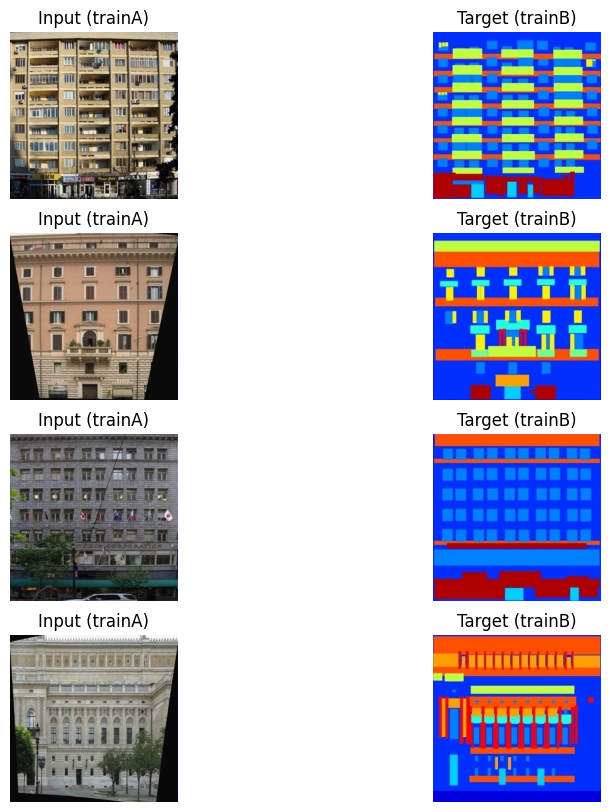

In [ ]:
def visualize_data(dataloader, num_samples=4):
    real_A, real_B = next(iter(dataloader))

    fig, axes = plt.subplots(num_samples, 2, figsize=(10, 10))

    for i in range(num_samples):
        img_A = real_A[i].permute(1, 2, 0).numpy() * 0.5 + 0.5
        img_B = real_B[i].permute(1, 2, 0).numpy() * 0.5 + 0.5

        axes[i, 0].imshow(img_A)
        axes[i, 0].set_title("Input (trainA)")
        axes[i, 0].axis("off")

        axes[i, 1].imshow(img_B)
        axes[i, 1].set_title("Target (trainB)")
        axes[i, 1].axis("off")

    plt.show()

visualize_data(dataloader)

### pix2pix cGAN

#### U-Net-based Generator

In [ ]:
class UNetGenerator(nn.Module):
    def __init__(self):
        super(UNetGenerator, self).__init__()
        def downsample(in_channels, out_channels, apply_batchnorm=True):
            layers = [nn.Conv2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False)]
            if apply_batchnorm:
                layers.append(nn.BatchNorm2d(out_channels))
            layers.append(nn.LeakyReLU(0.2))
            return nn.Sequential(*layers)

        def upsample(in_channels, out_channels, apply_dropout=False):
            layers = [nn.ConvTranspose2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False),
                      nn.BatchNorm2d(out_channels)]
            if apply_dropout:
                layers.append(nn.Dropout(0.5))
            layers.append(nn.ReLU())
            return nn.Sequential(*layers)

        self.down1 = downsample(3, 64, apply_batchnorm=False)
        self.down2 = downsample(64, 128)
        self.down3 = downsample(128, 256)
        self.down4 = downsample(256, 512)
        self.down5 = downsample(512, 512)
        self.down6 = downsample(512, 512)
        self.down7 = downsample(512, 512)
        self.down8 = downsample(512, 512)

        self.up1 = upsample(512, 512, apply_dropout=True)
        self.up2 = upsample(1024, 512, apply_dropout=True)
        self.up3 = upsample(1024, 512, apply_dropout=True)
        self.up4 = upsample(1024, 512)
        self.up5 = upsample(1024, 256)
        self.up6 = upsample(512, 128)
        self.up7 = upsample(256, 64)
        self.up8 = nn.Sequential(
            nn.ConvTranspose2d(128, 3, 4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        d8 = self.down8(d7)

        u1 = self.up1(d8)
        u2 = self.up2(torch.cat([u1, d7], 1))
        u3 = self.up3(torch.cat([u2, d6], 1))
        u4 = self.up4(torch.cat([u3, d5], 1))
        u5 = self.up5(torch.cat([u4, d4], 1))
        u6 = self.up6(torch.cat([u5, d3], 1))
        u7 = self.up7(torch.cat([u6, d2], 1))
        u8 = self.up8(torch.cat([u7, d1], 1))
        return u8

#### PatchGAN Discriminator

In [ ]:
class PatchGANDiscriminator(nn.Module):
    def __init__(self):
        super(PatchGANDiscriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(6, 64, 4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, 4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Conv2d(128, 256, 4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),
            nn.Conv2d(256, 512, 4, stride=1, padding=1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
            nn.Conv2d(512, 1, 4, stride=1, padding=1)
        )
    def forward(self, x):
        return self.model(x)

### Training

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
loss_G_list, loss_D_list, is_scores, fid_scores = [], [], [], []

def train(generator, discriminator, dataloader, num_epochs=120):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    generator.to(device)
    discriminator.to(device)
    generator.apply(weights_init)
    discriminator.apply(weights_init)

    criterion_GAN = nn.BCEWithLogitsLoss()
    criterion_L1 = nn.L1Loss()
    optimizer_G = optim.Adam(generator.parameters(), lr=2e-4, betas=(0.5, 0.999))
    optimizer_D = optim.Adam(discriminator.parameters(), lr=2e-4, betas=(0.5, 0.999))

    inception_score = InceptionScore(normalize=True).to(device)
    fid_score = FrechetInceptionDistance(normalize=True).to(device)

    for epoch in range(num_epochs):
        epoch_loss_G, epoch_loss_D = 0, 0

        for i, (input_img, target_img) in enumerate(dataloader):
            input_img, target_img = input_img.to(device), target_img.to(device)

            # generate fake image
            fake_img = generator(input_img)

            # discriminator update
            discriminator_real = discriminator(torch.cat([input_img, target_img], dim=1))
            discriminator_fake = discriminator(torch.cat([input_img, fake_img.detach()], dim=1))

            real_labels = torch.ones_like(discriminator_real).to(device)
            fake_labels = torch.zeros_like(discriminator_fake).to(device)

            loss_D_real = criterion_GAN(discriminator_real, real_labels)
            loss_D_fake = criterion_GAN(discriminator_fake, fake_labels)
            loss_D = (loss_D_real + loss_D_fake) / 2

            optimizer_D.zero_grad()
            loss_D.backward()
            optimizer_D.step()

            # generator update
            discriminator_fake = discriminator(torch.cat([input_img, fake_img], dim=1))
            loss_G_GAN = criterion_GAN(discriminator_fake, real_labels)
            loss_G_L1 = criterion_L1(fake_img, target_img)
            loss_G = loss_G_GAN + 100 * loss_G_L1

            optimizer_G.zero_grad()
            loss_G.backward()
            optimizer_G.step()

            epoch_loss_D += loss_D.item()
            epoch_loss_G += loss_G.item()

        print("---------------------------------------------------------------")
        print(f"Epoch {epoch+1}/{num_epochs}, Loss D: {loss_D.item()}, Loss G: {loss_G.item()}")

        loss_G_list.append(epoch_loss_G / len(dataloader))
        loss_D_list.append(epoch_loss_D / len(dataloader))

        with torch.no_grad():
            plt.figure(figsize=(10, 10))
            plt.axis("off")
            plt.title(f"Epoch {epoch+1} Generated Images")
            grid = vutils.make_grid(fake_img[:16], normalize=True, scale_each=True)
            plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
            plt.show()

            inception_score.update(fake_img)
            fid_score.update(fake_img, real=False)
            fid_score.update(target_img, real=True)

            is_mean, is_std = inception_score.compute()
            fid_value = fid_score.compute()

            print(f"Inception Score (IS): {is_mean:.4f} ± {is_std:.4f}")
            print(f"Fréchet Inception Distance (FID): {fid_value:.4f}")

            is_scores.append(is_mean.item())
            fid_scores.append(fid_value.item())

/usr/local/lib/python3.11/dist-packages/torchmetrics/utilities/prints.py:43: UserWarning: Metric `InceptionScore` will save all extracted features in buffer. For large datasets this may lead to large memory footprint.
  warnings.warn(*args, **kwargs)
Downloading: "https://github.com/toshas/torch-fidelity/releases/download/v0.2.0/weights-inception-2015-12-05-6726825d.pth" to /root/.cache/torch/hub/checkpoints/weights-inception-2015-12-05-6726825d.pth
100%|██████████| 91.2M/91.2M [00:00<00:00, 110MB/s]


---------------------------------------------------------------
Epoch 1/120, Loss D: 0.09580951929092407, Loss G: 47.8113899230957


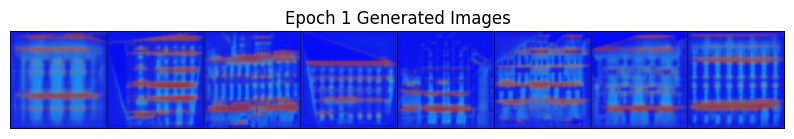

Inception Score (IS): 1.0000 ± 0.0000
Fréchet Inception Distance (FID): 446.4368
---------------------------------------------------------------
Epoch 2/120, Loss D: 0.051963530480861664, Loss G: 40.05720520019531


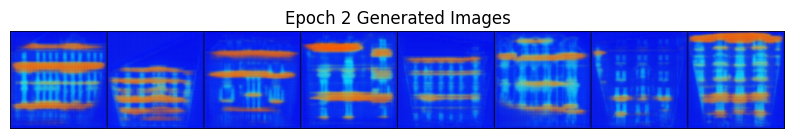

Inception Score (IS): 1.3815 ± 0.2400
Fréchet Inception Distance (FID): 388.4026
---------------------------------------------------------------
Epoch 3/120, Loss D: 0.024639476090669632, Loss G: 41.35373306274414


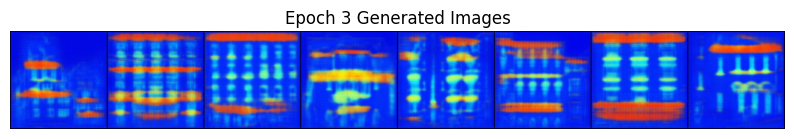

Inception Score (IS): 1.6273 ± 0.1694
Fréchet Inception Distance (FID): 371.6788
---------------------------------------------------------------
Epoch 4/120, Loss D: 0.06747916340827942, Loss G: 38.171871185302734


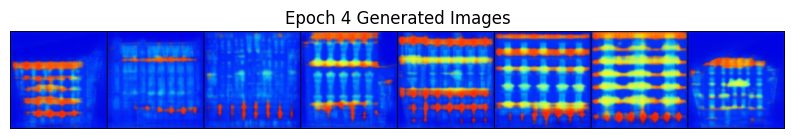

Inception Score (IS): 1.7488 ± 0.3153
Fréchet Inception Distance (FID): 368.6474
---------------------------------------------------------------
Epoch 5/120, Loss D: 0.13642066717147827, Loss G: 39.96929931640625


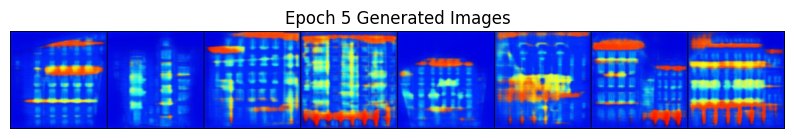

Inception Score (IS): 1.7941 ± 0.2446
Fréchet Inception Distance (FID): 345.4876
---------------------------------------------------------------
Epoch 6/120, Loss D: 0.04244162142276764, Loss G: 42.010616302490234


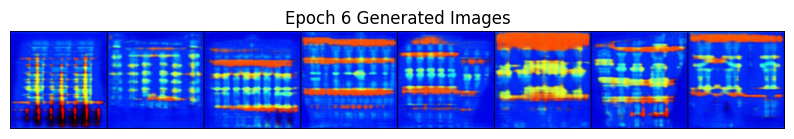

Inception Score (IS): 1.7415 ± 0.3036
Fréchet Inception Distance (FID): 341.3292
---------------------------------------------------------------
Epoch 7/120, Loss D: 0.049742404371500015, Loss G: 41.37702941894531


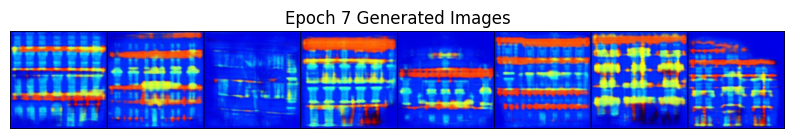

Inception Score (IS): 1.8942 ± 0.3267
Fréchet Inception Distance (FID): 341.2652
---------------------------------------------------------------
Epoch 8/120, Loss D: 0.09719401597976685, Loss G: 32.573062896728516


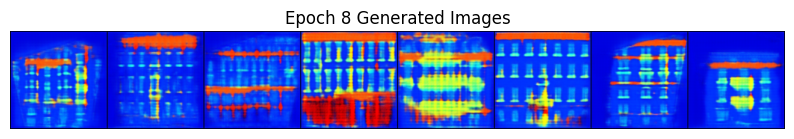

Inception Score (IS): 1.8838 ± 0.3471
Fréchet Inception Distance (FID): 330.2498
---------------------------------------------------------------
Epoch 9/120, Loss D: 0.4774637520313263, Loss G: 29.35727882385254


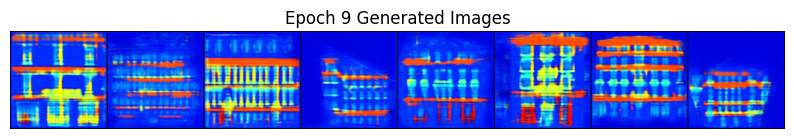

Inception Score (IS): 2.1226 ± 0.1916
Fréchet Inception Distance (FID): 318.1683
---------------------------------------------------------------
Epoch 10/120, Loss D: 0.22761563956737518, Loss G: 31.245582580566406


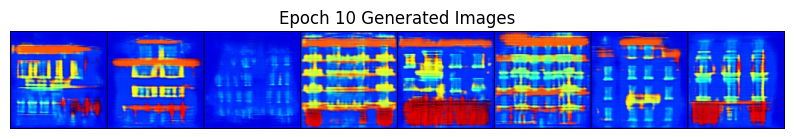

Inception Score (IS): 2.1738 ± 0.2265
Fréchet Inception Distance (FID): 314.5758
---------------------------------------------------------------
Epoch 11/120, Loss D: 0.1946769803762436, Loss G: 32.147483825683594


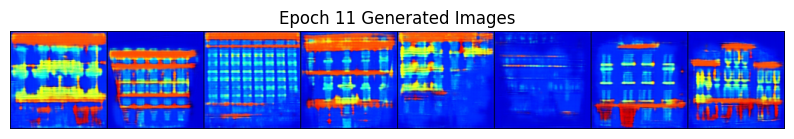

Inception Score (IS): 2.2803 ± 0.3358
Fréchet Inception Distance (FID): 311.0901
---------------------------------------------------------------
Epoch 12/120, Loss D: 0.3236200511455536, Loss G: 27.743896484375


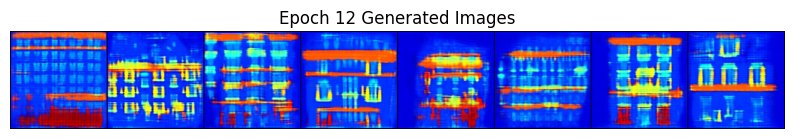

Inception Score (IS): 2.3116 ± 0.3292
Fréchet Inception Distance (FID): 308.2541
---------------------------------------------------------------
Epoch 13/120, Loss D: 1.4087480306625366, Loss G: 26.29334259033203


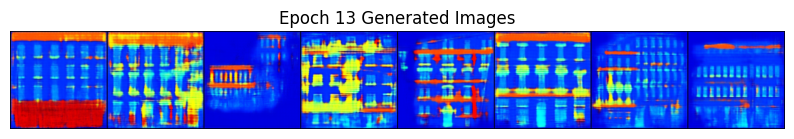

Inception Score (IS): 2.3691 ± 0.3249
Fréchet Inception Distance (FID): 304.2982
---------------------------------------------------------------
Epoch 14/120, Loss D: 0.20815648138523102, Loss G: 26.300264358520508


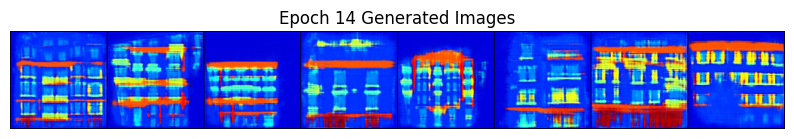

Inception Score (IS): 2.3365 ± 0.2843
Fréchet Inception Distance (FID): 300.7340
---------------------------------------------------------------
Epoch 15/120, Loss D: 0.24184896051883698, Loss G: 26.705238342285156


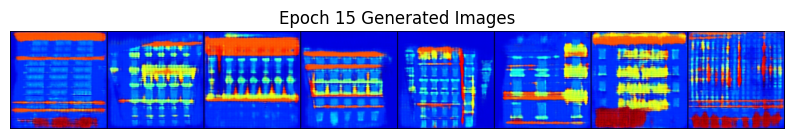

Inception Score (IS): 2.4208 ± 0.3083
Fréchet Inception Distance (FID): 293.9687
---------------------------------------------------------------
Epoch 16/120, Loss D: 0.21604031324386597, Loss G: 27.677818298339844


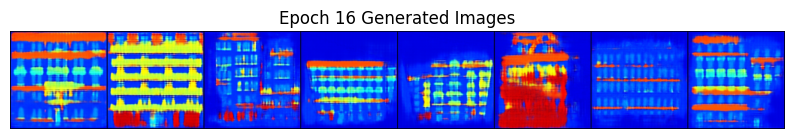

Inception Score (IS): 2.5622 ± 0.2863
Fréchet Inception Distance (FID): 288.8885
---------------------------------------------------------------
Epoch 17/120, Loss D: 0.1653992235660553, Loss G: 24.516469955444336


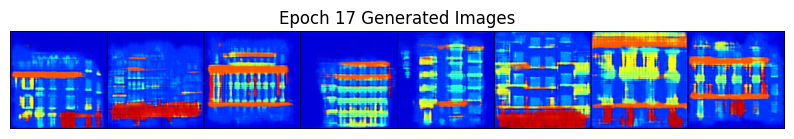

Inception Score (IS): 2.5451 ± 0.2525
Fréchet Inception Distance (FID): 284.9432
---------------------------------------------------------------
Epoch 18/120, Loss D: 0.5616709589958191, Loss G: 22.762941360473633


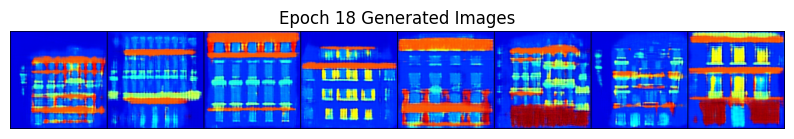

Inception Score (IS): 2.5665 ± 0.3484
Fréchet Inception Distance (FID): 279.2387
---------------------------------------------------------------
Epoch 19/120, Loss D: 0.3505716919898987, Loss G: 20.25581169128418


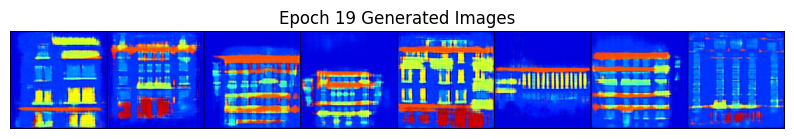

Inception Score (IS): 2.6215 ± 0.2846
Fréchet Inception Distance (FID): 274.8914
---------------------------------------------------------------
Epoch 20/120, Loss D: 0.4252033531665802, Loss G: 18.368663787841797


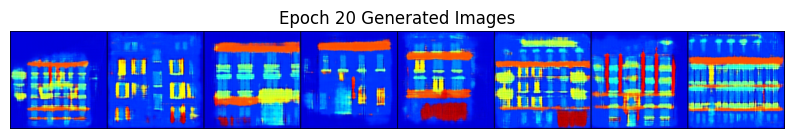

Inception Score (IS): 2.6635 ± 0.2173
Fréchet Inception Distance (FID): 272.2190
---------------------------------------------------------------
Epoch 21/120, Loss D: 0.46989572048187256, Loss G: 19.315853118896484


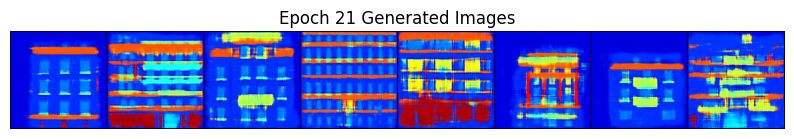

Inception Score (IS): 2.6500 ± 0.3080
Fréchet Inception Distance (FID): 268.4818
---------------------------------------------------------------
Epoch 22/120, Loss D: 0.5873976945877075, Loss G: 17.828453063964844


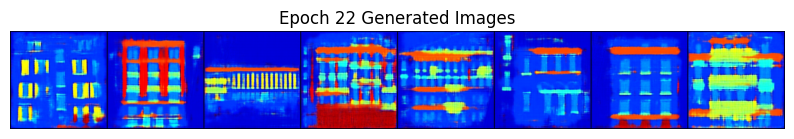

Inception Score (IS): 2.6639 ± 0.2145
Fréchet Inception Distance (FID): 267.0063
---------------------------------------------------------------
Epoch 23/120, Loss D: 0.44994261860847473, Loss G: 16.71358871459961


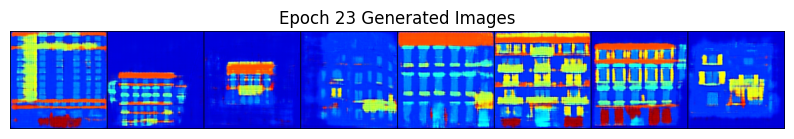

Inception Score (IS): 2.6818 ± 0.3041
Fréchet Inception Distance (FID): 264.3701
---------------------------------------------------------------
Epoch 24/120, Loss D: 0.3068031370639801, Loss G: 16.38666343688965


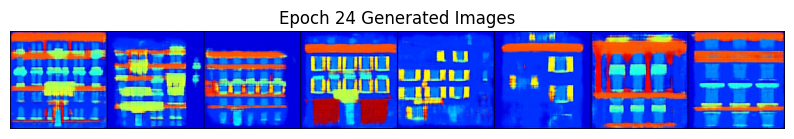

Inception Score (IS): 2.6938 ± 0.3580
Fréchet Inception Distance (FID): 261.6669
---------------------------------------------------------------
Epoch 25/120, Loss D: 0.23535136878490448, Loss G: 19.10516929626465


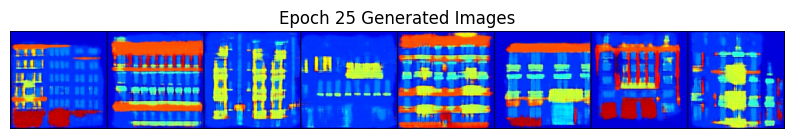

Inception Score (IS): 2.6923 ± 0.2882
Fréchet Inception Distance (FID): 258.7869
---------------------------------------------------------------
Epoch 26/120, Loss D: 0.5042693614959717, Loss G: 19.749418258666992


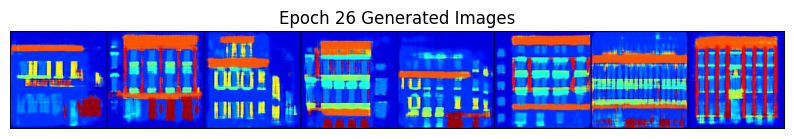

Inception Score (IS): 2.7433 ± 0.3041
Fréchet Inception Distance (FID): 255.8012
---------------------------------------------------------------
Epoch 27/120, Loss D: 0.5661053657531738, Loss G: 17.982881546020508


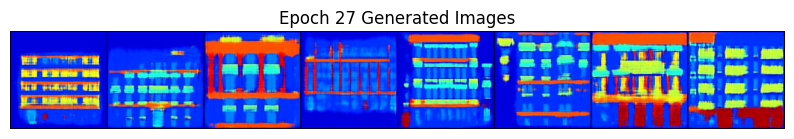

Inception Score (IS): 2.7076 ± 0.2634
Fréchet Inception Distance (FID): 252.9654
---------------------------------------------------------------
Epoch 28/120, Loss D: 0.4692946672439575, Loss G: 11.333759307861328


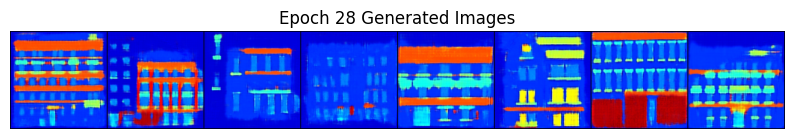

Inception Score (IS): 2.7923 ± 0.2579
Fréchet Inception Distance (FID): 251.1656
---------------------------------------------------------------
Epoch 29/120, Loss D: 0.2976638674736023, Loss G: 15.225954055786133


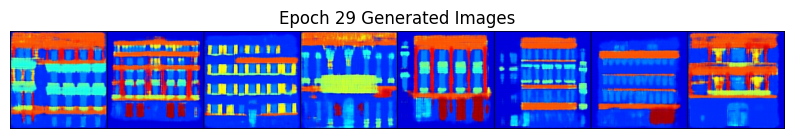

Inception Score (IS): 2.8594 ± 0.4106
Fréchet Inception Distance (FID): 248.6202
---------------------------------------------------------------
Epoch 30/120, Loss D: 0.36340996623039246, Loss G: 13.870176315307617


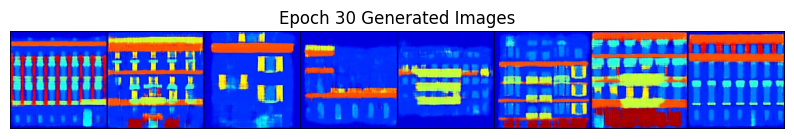

Inception Score (IS): 2.8322 ± 0.2757
Fréchet Inception Distance (FID): 246.3151
---------------------------------------------------------------
Epoch 31/120, Loss D: 0.6277899742126465, Loss G: 14.19078540802002


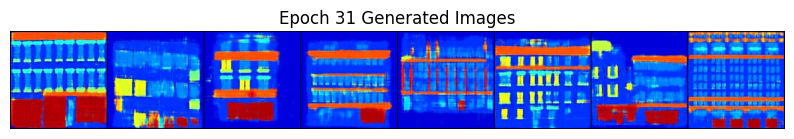

Inception Score (IS): 2.8903 ± 0.3138
Fréchet Inception Distance (FID): 244.1015
---------------------------------------------------------------
Epoch 32/120, Loss D: 0.2728908061981201, Loss G: 16.918062210083008


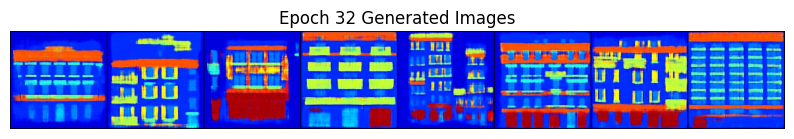

Inception Score (IS): 2.8254 ± 0.3281
Fréchet Inception Distance (FID): 241.3794
---------------------------------------------------------------
Epoch 33/120, Loss D: 0.23166429996490479, Loss G: 15.080856323242188


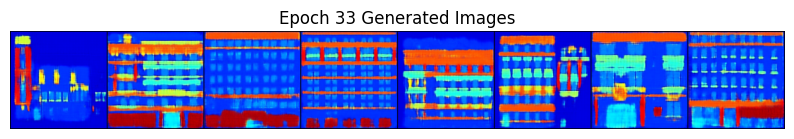

Inception Score (IS): 2.8775 ± 0.3668
Fréchet Inception Distance (FID): 239.1879
---------------------------------------------------------------
Epoch 34/120, Loss D: 0.11210449039936066, Loss G: 14.744982719421387


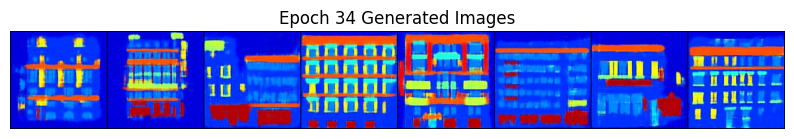

Inception Score (IS): 2.8901 ± 0.2779
Fréchet Inception Distance (FID): 236.0195
---------------------------------------------------------------
Epoch 35/120, Loss D: 0.4999484121799469, Loss G: 15.26685905456543


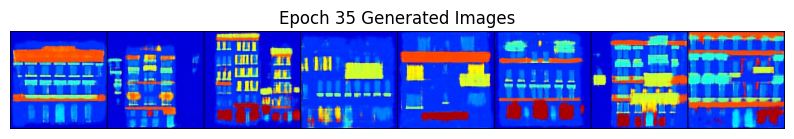

Inception Score (IS): 2.8781 ± 0.3101
Fréchet Inception Distance (FID): 234.8153
---------------------------------------------------------------
Epoch 36/120, Loss D: 0.12192961573600769, Loss G: 12.933420181274414


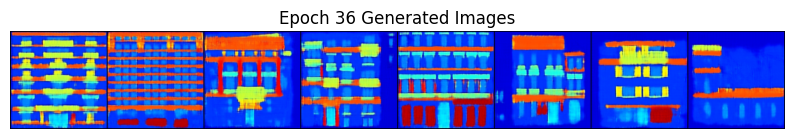

Inception Score (IS): 2.8674 ± 0.3739
Fréchet Inception Distance (FID): 233.6216
---------------------------------------------------------------
Epoch 37/120, Loss D: 0.08928915858268738, Loss G: 15.873618125915527


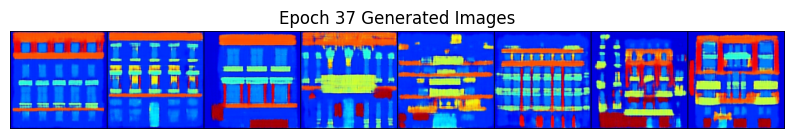

Inception Score (IS): 2.8781 ± 0.3193
Fréchet Inception Distance (FID): 232.9166
---------------------------------------------------------------
Epoch 38/120, Loss D: 0.9939261078834534, Loss G: 14.985137939453125


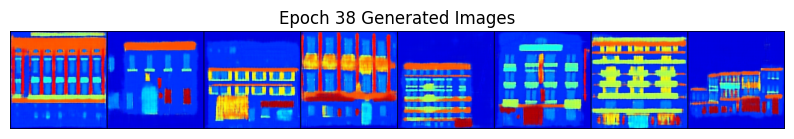

Inception Score (IS): 2.8488 ± 0.2593
Fréchet Inception Distance (FID): 231.0108
---------------------------------------------------------------
Epoch 39/120, Loss D: 0.46397191286087036, Loss G: 14.01096248626709


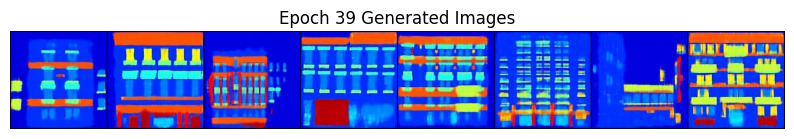

Inception Score (IS): 2.8768 ± 0.3215
Fréchet Inception Distance (FID): 229.3605
---------------------------------------------------------------
Epoch 40/120, Loss D: 1.1399312019348145, Loss G: 13.063051223754883


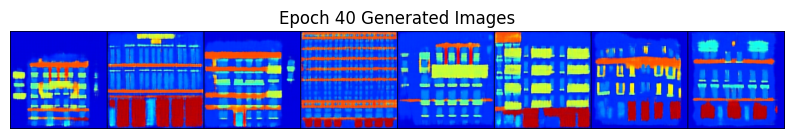

Inception Score (IS): 2.8655 ± 0.3661
Fréchet Inception Distance (FID): 227.3047
---------------------------------------------------------------
Epoch 41/120, Loss D: 0.2628713846206665, Loss G: 15.966560363769531


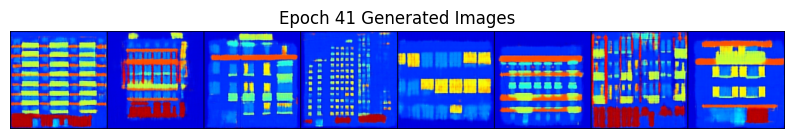

Inception Score (IS): 2.8725 ± 0.3675
Fréchet Inception Distance (FID): 225.5972
---------------------------------------------------------------
Epoch 42/120, Loss D: 0.08878394961357117, Loss G: 12.847162246704102


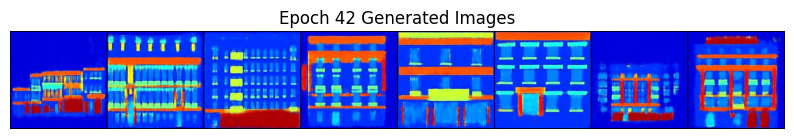

Inception Score (IS): 2.8989 ± 0.1902
Fréchet Inception Distance (FID): 223.7449
---------------------------------------------------------------
Epoch 43/120, Loss D: 0.8173243403434753, Loss G: 15.892894744873047


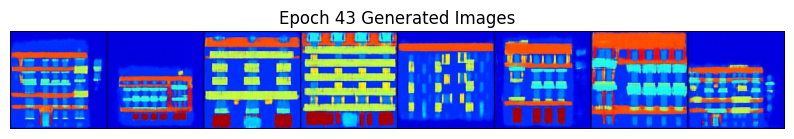

Inception Score (IS): 2.8776 ± 0.2877
Fréchet Inception Distance (FID): 222.3175
---------------------------------------------------------------
Epoch 44/120, Loss D: 0.82023686170578, Loss G: 15.235184669494629


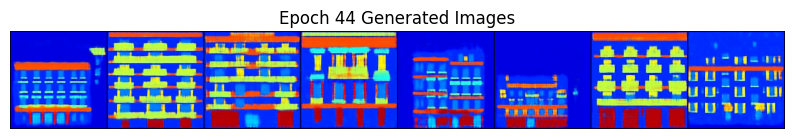

Inception Score (IS): 2.8605 ± 0.1652
Fréchet Inception Distance (FID): 220.6519
---------------------------------------------------------------
Epoch 45/120, Loss D: 1.2357159852981567, Loss G: 10.052587509155273


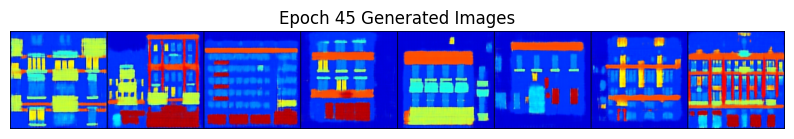

Inception Score (IS): 2.8925 ± 0.1685
Fréchet Inception Distance (FID): 219.2812
---------------------------------------------------------------
Epoch 46/120, Loss D: 0.1870599091053009, Loss G: 12.369705200195312


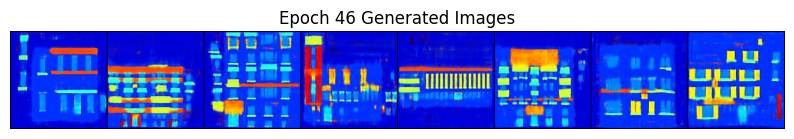

Inception Score (IS): 2.8668 ± 0.2831
Fréchet Inception Distance (FID): 218.2785
---------------------------------------------------------------
Epoch 47/120, Loss D: 0.3962128460407257, Loss G: 15.296796798706055


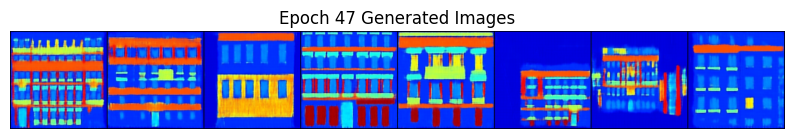

Inception Score (IS): 2.9080 ± 0.3686
Fréchet Inception Distance (FID): 216.8031
---------------------------------------------------------------
Epoch 48/120, Loss D: 0.46658265590667725, Loss G: 13.760614395141602


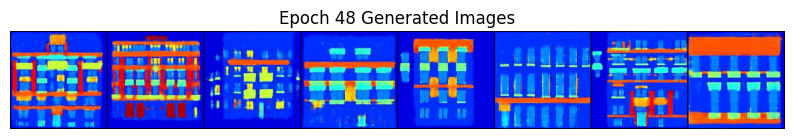

Inception Score (IS): 2.8608 ± 0.2787
Fréchet Inception Distance (FID): 215.8976
---------------------------------------------------------------
Epoch 49/120, Loss D: 0.15903009474277496, Loss G: 11.744067192077637


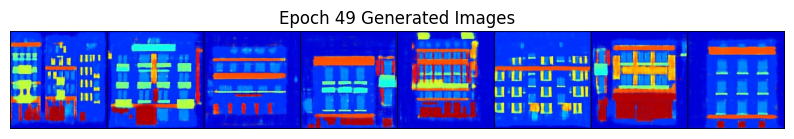

Inception Score (IS): 2.8575 ± 0.2233
Fréchet Inception Distance (FID): 214.9954
---------------------------------------------------------------
Epoch 50/120, Loss D: 0.047350116074085236, Loss G: 14.520419120788574


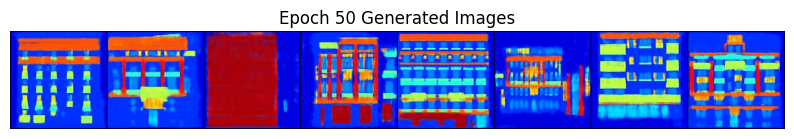

Inception Score (IS): 2.8895 ± 0.2927
Fréchet Inception Distance (FID): 213.8751
---------------------------------------------------------------
Epoch 51/120, Loss D: 0.07407742738723755, Loss G: 10.32711124420166


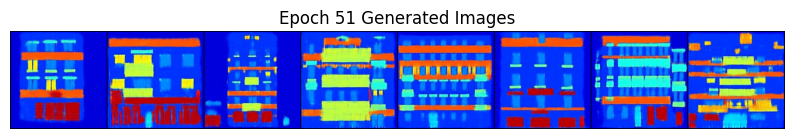

Inception Score (IS): 2.8957 ± 0.2756
Fréchet Inception Distance (FID): 212.4173
---------------------------------------------------------------
Epoch 52/120, Loss D: 0.31164222955703735, Loss G: 11.208368301391602


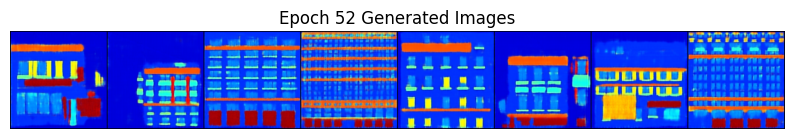

Inception Score (IS): 2.8806 ± 0.2168
Fréchet Inception Distance (FID): 210.5404
---------------------------------------------------------------
Epoch 53/120, Loss D: 0.12083062529563904, Loss G: 10.192499160766602


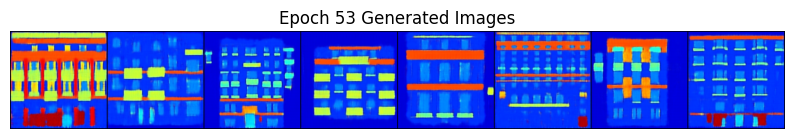

Inception Score (IS): 2.8816 ± 0.2504
Fréchet Inception Distance (FID): 209.5070
---------------------------------------------------------------
Epoch 54/120, Loss D: 0.1365068405866623, Loss G: 9.90614128112793


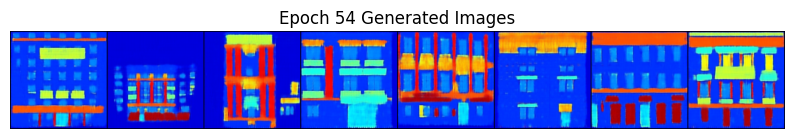

Inception Score (IS): 2.9237 ± 0.3098
Fréchet Inception Distance (FID): 208.4135
---------------------------------------------------------------
Epoch 55/120, Loss D: 0.3182903230190277, Loss G: 11.006046295166016


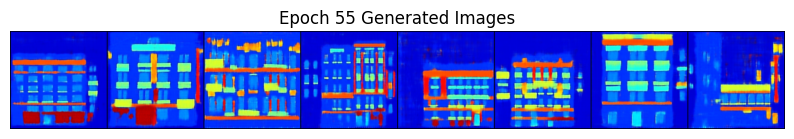

Inception Score (IS): 2.8967 ± 0.2230
Fréchet Inception Distance (FID): 207.1761
---------------------------------------------------------------
Epoch 56/120, Loss D: 0.03511785343289375, Loss G: 12.330110549926758


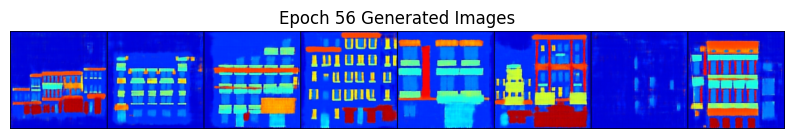

Inception Score (IS): 2.8896 ± 0.2342
Fréchet Inception Distance (FID): 206.0954
---------------------------------------------------------------
Epoch 57/120, Loss D: 0.11016464233398438, Loss G: 12.097214698791504


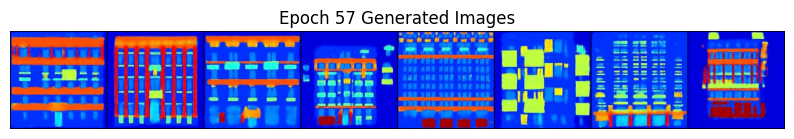

Inception Score (IS): 2.9016 ± 0.1863
Fréchet Inception Distance (FID): 205.1494
---------------------------------------------------------------
Epoch 58/120, Loss D: 0.1112879291176796, Loss G: 10.074337005615234


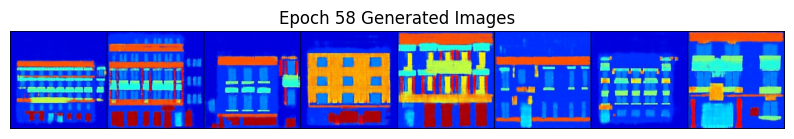

Inception Score (IS): 2.9025 ± 0.2677
Fréchet Inception Distance (FID): 204.0383
---------------------------------------------------------------
Epoch 59/120, Loss D: 0.5643594264984131, Loss G: 10.481901168823242


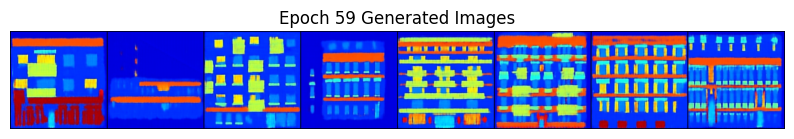

Inception Score (IS): 2.9122 ± 0.2088
Fréchet Inception Distance (FID): 202.7088
---------------------------------------------------------------
Epoch 60/120, Loss D: 0.044140949845314026, Loss G: 11.23330307006836


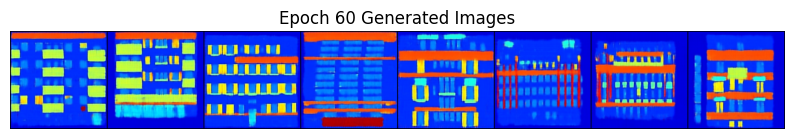

Inception Score (IS): 2.9289 ± 0.3243
Fréchet Inception Distance (FID): 201.4249
---------------------------------------------------------------
Epoch 61/120, Loss D: 0.06394907087087631, Loss G: 11.31342887878418


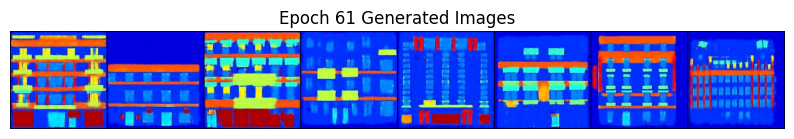

Inception Score (IS): 2.9127 ± 0.2608
Fréchet Inception Distance (FID): 201.2655
---------------------------------------------------------------
Epoch 62/120, Loss D: 0.022239776328206062, Loss G: 13.460817337036133


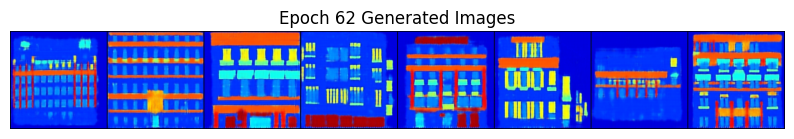

Inception Score (IS): 2.9138 ± 0.2000
Fréchet Inception Distance (FID): 200.0191
---------------------------------------------------------------
Epoch 63/120, Loss D: 0.25677490234375, Loss G: 12.945613861083984


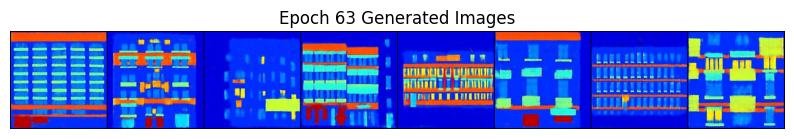

Inception Score (IS): 2.9248 ± 0.2913
Fréchet Inception Distance (FID): 198.7414
---------------------------------------------------------------
Epoch 64/120, Loss D: 0.30720025300979614, Loss G: 9.75349235534668


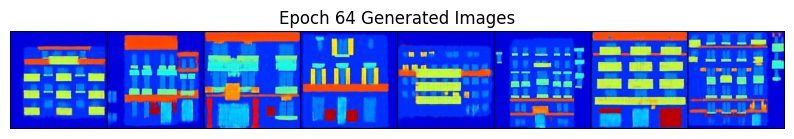

Inception Score (IS): 2.9174 ± 0.2859
Fréchet Inception Distance (FID): 197.9651
---------------------------------------------------------------
Epoch 65/120, Loss D: 0.132712721824646, Loss G: 9.887626647949219


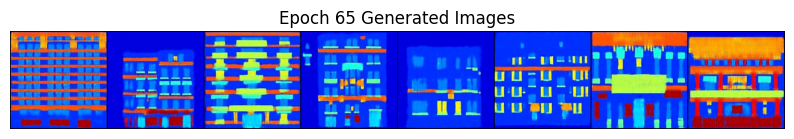

Inception Score (IS): 2.9038 ± 0.2135
Fréchet Inception Distance (FID): 197.1424
---------------------------------------------------------------
Epoch 66/120, Loss D: 0.33679741621017456, Loss G: 9.325961112976074


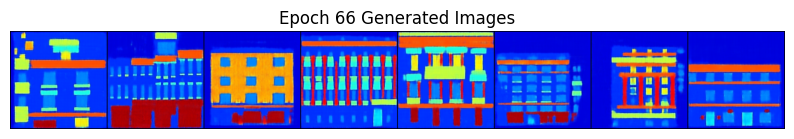

Inception Score (IS): 2.9146 ± 0.3571
Fréchet Inception Distance (FID): 196.5523
---------------------------------------------------------------
Epoch 67/120, Loss D: 0.19439129531383514, Loss G: 8.370013236999512


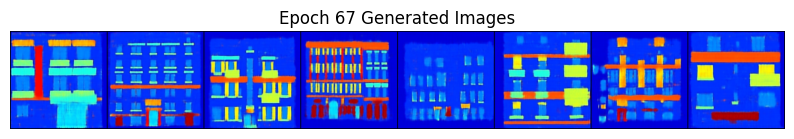

Inception Score (IS): 2.9142 ± 0.2566
Fréchet Inception Distance (FID): 196.1113
---------------------------------------------------------------
Epoch 68/120, Loss D: 0.0803738385438919, Loss G: 9.827849388122559


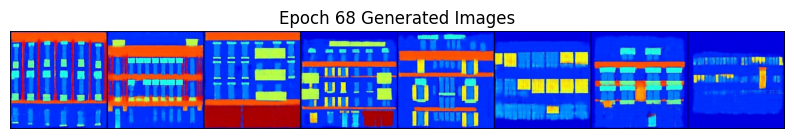

Inception Score (IS): 2.9157 ± 0.3022
Fréchet Inception Distance (FID): 195.1908
---------------------------------------------------------------
Epoch 69/120, Loss D: 0.160810187458992, Loss G: 9.456068992614746


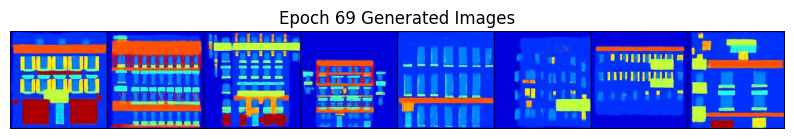

Inception Score (IS): 2.9449 ± 0.2207
Fréchet Inception Distance (FID): 194.2394
---------------------------------------------------------------
Epoch 70/120, Loss D: 0.045144230127334595, Loss G: 11.304913520812988


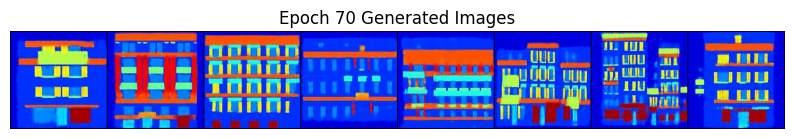

Inception Score (IS): 2.9069 ± 0.2363
Fréchet Inception Distance (FID): 193.3304
---------------------------------------------------------------
Epoch 71/120, Loss D: 0.4547913372516632, Loss G: 7.854299545288086


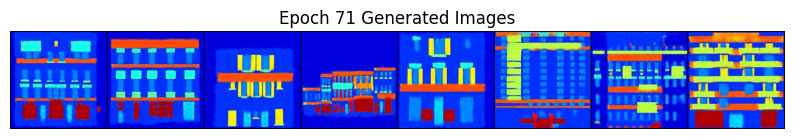

Inception Score (IS): 2.9282 ± 0.1872
Fréchet Inception Distance (FID): 192.2521
---------------------------------------------------------------
Epoch 72/120, Loss D: 0.055119842290878296, Loss G: 10.473272323608398


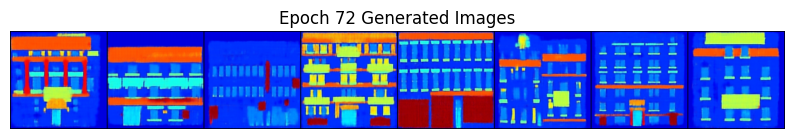

Inception Score (IS): 2.9299 ± 0.2478
Fréchet Inception Distance (FID): 191.7521
---------------------------------------------------------------
Epoch 73/120, Loss D: 0.017572693526744843, Loss G: 13.357086181640625


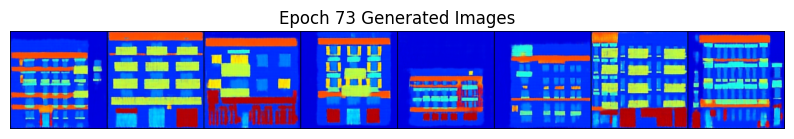

Inception Score (IS): 2.9619 ± 0.2284
Fréchet Inception Distance (FID): 190.9389
---------------------------------------------------------------
Epoch 74/120, Loss D: 0.6368218660354614, Loss G: 15.178083419799805


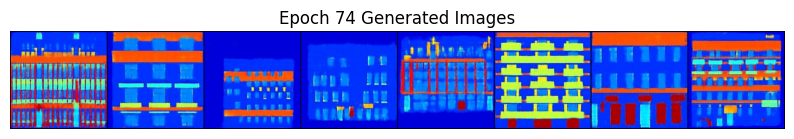

Inception Score (IS): 2.9463 ± 0.1734
Fréchet Inception Distance (FID): 190.4148
---------------------------------------------------------------
Epoch 75/120, Loss D: 0.6491499543190002, Loss G: 7.908803462982178


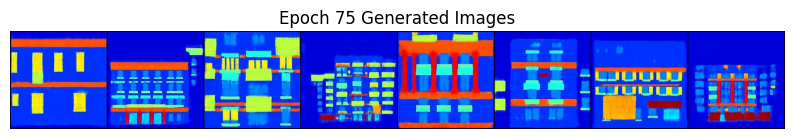

Inception Score (IS): 2.9391 ± 0.2047
Fréchet Inception Distance (FID): 189.6709
---------------------------------------------------------------
Epoch 76/120, Loss D: 0.14669570326805115, Loss G: 8.523351669311523


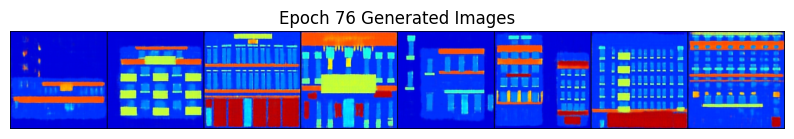

Inception Score (IS): 2.9481 ± 0.2422
Fréchet Inception Distance (FID): 188.7926
---------------------------------------------------------------
Epoch 77/120, Loss D: 0.27059975266456604, Loss G: 9.478275299072266


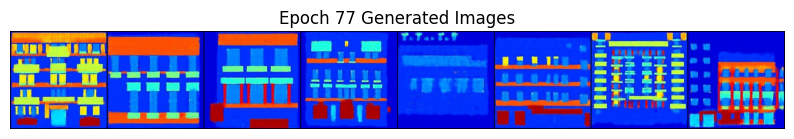

Inception Score (IS): 2.9735 ± 0.1817
Fréchet Inception Distance (FID): 188.0288
---------------------------------------------------------------
Epoch 78/120, Loss D: 0.11134153604507446, Loss G: 8.549710273742676


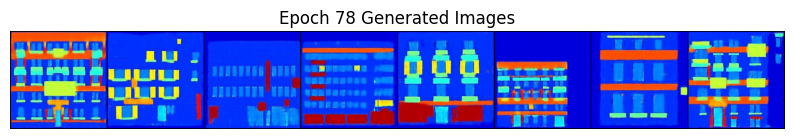

Inception Score (IS): 2.9693 ± 0.2130
Fréchet Inception Distance (FID): 187.6058
---------------------------------------------------------------
Epoch 79/120, Loss D: 0.3480488657951355, Loss G: 8.49533462524414


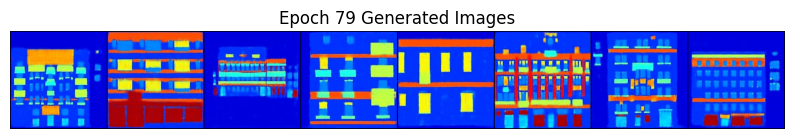

Inception Score (IS): 2.9497 ± 0.1984
Fréchet Inception Distance (FID): 186.8951
---------------------------------------------------------------
Epoch 80/120, Loss D: 0.026322074234485626, Loss G: 9.868134498596191


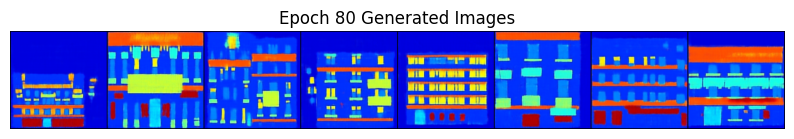

Inception Score (IS): 2.9556 ± 0.1679
Fréchet Inception Distance (FID): 186.5414
---------------------------------------------------------------
Epoch 81/120, Loss D: 0.02526750974357128, Loss G: 11.190658569335938


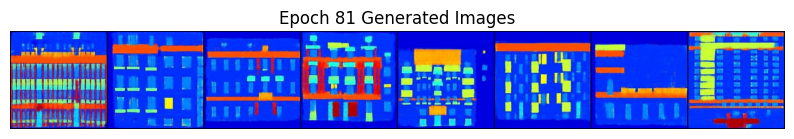

Inception Score (IS): 2.9517 ± 0.2345
Fréchet Inception Distance (FID): 186.0345
---------------------------------------------------------------
Epoch 82/120, Loss D: 0.009220733307301998, Loss G: 13.744348526000977


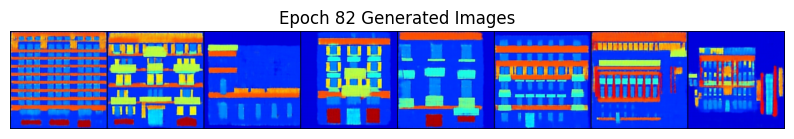

Inception Score (IS): 2.9616 ± 0.1723
Fréchet Inception Distance (FID): 185.7650
---------------------------------------------------------------
Epoch 83/120, Loss D: 0.008904892019927502, Loss G: 12.349751472473145


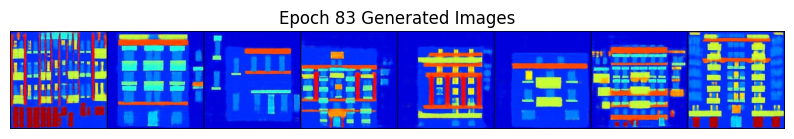

Inception Score (IS): 2.9962 ± 0.2456
Fréchet Inception Distance (FID): 185.1634
---------------------------------------------------------------
Epoch 84/120, Loss D: 0.5401977896690369, Loss G: 11.759247779846191


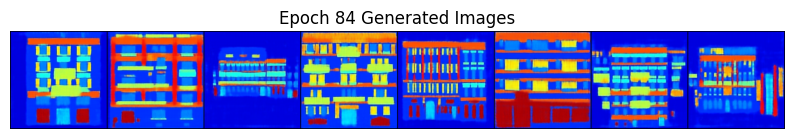

Inception Score (IS): 2.9894 ± 0.2002
Fréchet Inception Distance (FID): 184.7583
---------------------------------------------------------------
Epoch 85/120, Loss D: 0.4277094006538391, Loss G: 9.422330856323242


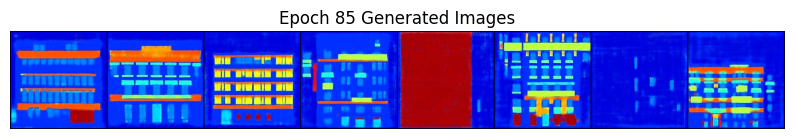

Inception Score (IS): 2.9950 ± 0.1769
Fréchet Inception Distance (FID): 183.9349
---------------------------------------------------------------
Epoch 86/120, Loss D: 0.6452040076255798, Loss G: 7.8842573165893555


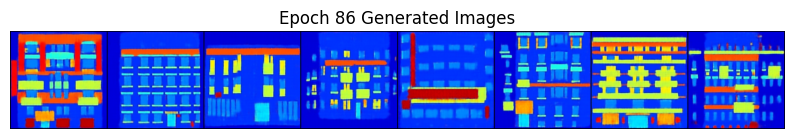

Inception Score (IS): 2.9761 ± 0.1882
Fréchet Inception Distance (FID): 183.2991
---------------------------------------------------------------
Epoch 87/120, Loss D: 0.06148285046219826, Loss G: 9.540796279907227


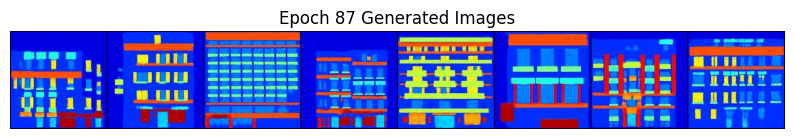

Inception Score (IS): 2.9988 ± 0.2843
Fréchet Inception Distance (FID): 182.4502
---------------------------------------------------------------
Epoch 88/120, Loss D: 0.029523080214858055, Loss G: 10.383770942687988


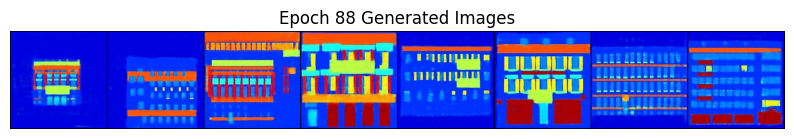

Inception Score (IS): 3.0183 ± 0.1645
Fréchet Inception Distance (FID): 181.6642
---------------------------------------------------------------
Epoch 89/120, Loss D: 0.020250752568244934, Loss G: 10.665424346923828


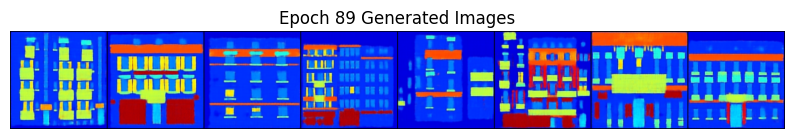

Inception Score (IS): 3.0211 ± 0.1580
Fréchet Inception Distance (FID): 181.6366
---------------------------------------------------------------
Epoch 90/120, Loss D: 1.6861186027526855, Loss G: 6.565291404724121


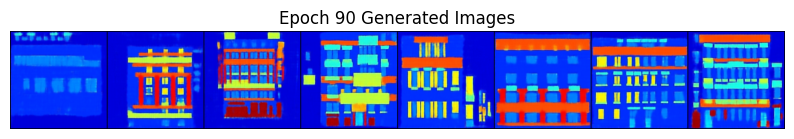

Inception Score (IS): 3.0253 ± 0.1885
Fréchet Inception Distance (FID): 180.7510
---------------------------------------------------------------
Epoch 91/120, Loss D: 0.03817632794380188, Loss G: 10.335381507873535


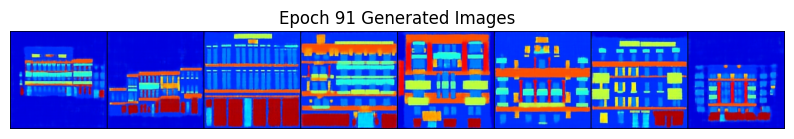

Inception Score (IS): 3.0444 ± 0.2519
Fréchet Inception Distance (FID): 180.2508
---------------------------------------------------------------
Epoch 92/120, Loss D: 0.7322860360145569, Loss G: 7.8032379150390625


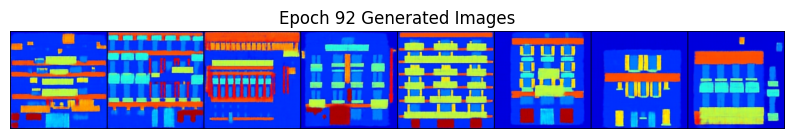

Inception Score (IS): 3.0370 ± 0.2764
Fréchet Inception Distance (FID): 180.3340
---------------------------------------------------------------
Epoch 93/120, Loss D: 0.2742156982421875, Loss G: 8.727889060974121


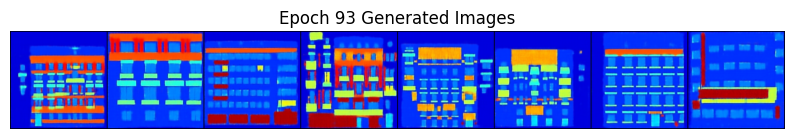

Inception Score (IS): 3.0451 ± 0.2448
Fréchet Inception Distance (FID): 179.5365
---------------------------------------------------------------
Epoch 94/120, Loss D: 0.05621416121721268, Loss G: 7.928420066833496


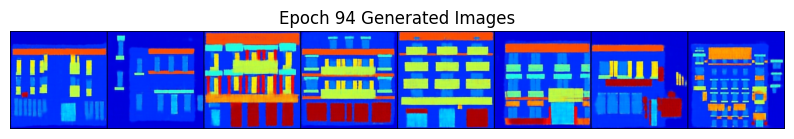

Inception Score (IS): 3.0409 ± 0.2050
Fréchet Inception Distance (FID): 178.8871
---------------------------------------------------------------
Epoch 95/120, Loss D: 0.04523027688264847, Loss G: 11.271513938903809


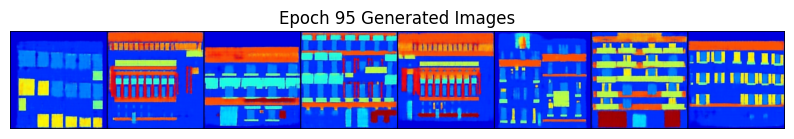

Inception Score (IS): 3.0316 ± 0.1652
Fréchet Inception Distance (FID): 178.5588
---------------------------------------------------------------
Epoch 96/120, Loss D: 0.06481584161520004, Loss G: 8.518035888671875


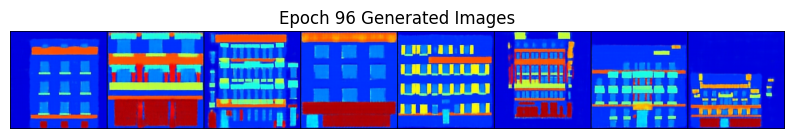

Inception Score (IS): 3.0325 ± 0.2423
Fréchet Inception Distance (FID): 178.1785
---------------------------------------------------------------
Epoch 97/120, Loss D: 0.0249209962785244, Loss G: 10.929550170898438


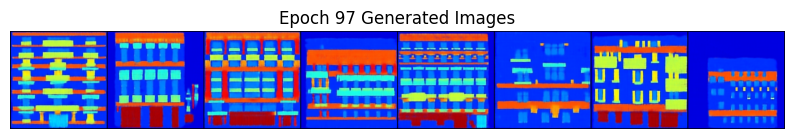

Inception Score (IS): 3.0283 ± 0.2379
Fréchet Inception Distance (FID): 177.8108
---------------------------------------------------------------
Epoch 98/120, Loss D: 0.02007187344133854, Loss G: 12.267616271972656


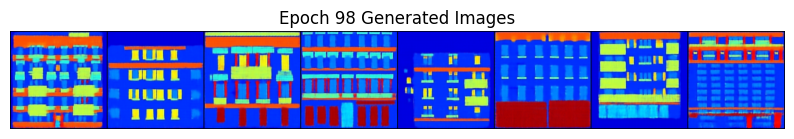

Inception Score (IS): 3.0209 ± 0.2181
Fréchet Inception Distance (FID): 177.3076
---------------------------------------------------------------
Epoch 99/120, Loss D: 0.07863015681505203, Loss G: 11.755203247070312


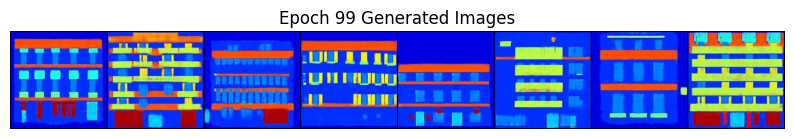

Inception Score (IS): 3.0368 ± 0.2330
Fréchet Inception Distance (FID): 176.9476
---------------------------------------------------------------
Epoch 100/120, Loss D: 0.01254948414862156, Loss G: 11.896856307983398


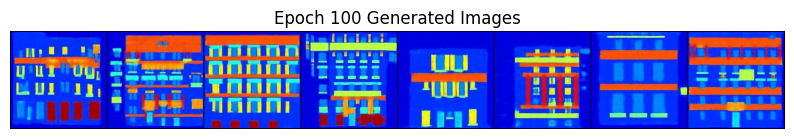

Inception Score (IS): 3.0388 ± 0.1407
Fréchet Inception Distance (FID): 176.4351
---------------------------------------------------------------
Epoch 101/120, Loss D: 0.6441000699996948, Loss G: 6.591217041015625


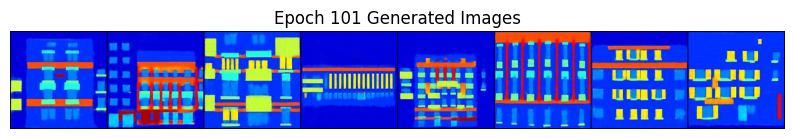

Inception Score (IS): 3.0507 ± 0.1858
Fréchet Inception Distance (FID): 176.1075
---------------------------------------------------------------
Epoch 102/120, Loss D: 0.42591434717178345, Loss G: 6.748335361480713


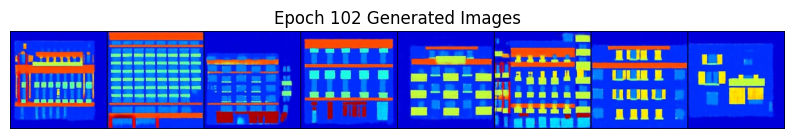

Inception Score (IS): 3.0584 ± 0.1014
Fréchet Inception Distance (FID): 175.5172
---------------------------------------------------------------
Epoch 103/120, Loss D: 0.6352207064628601, Loss G: 9.354578018188477


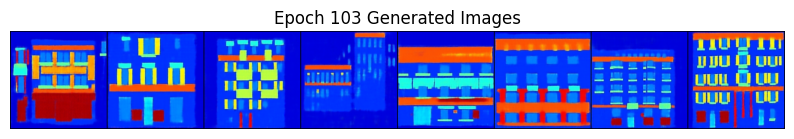

Inception Score (IS): 3.0660 ± 0.2229
Fréchet Inception Distance (FID): 174.9348
---------------------------------------------------------------
Epoch 104/120, Loss D: 1.0750802755355835, Loss G: 5.767351150512695


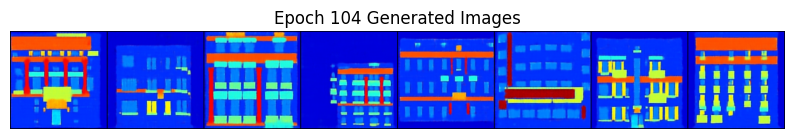

Inception Score (IS): 3.0721 ± 0.2565
Fréchet Inception Distance (FID): 174.6600
---------------------------------------------------------------
Epoch 105/120, Loss D: 0.5520068407058716, Loss G: 8.18515396118164


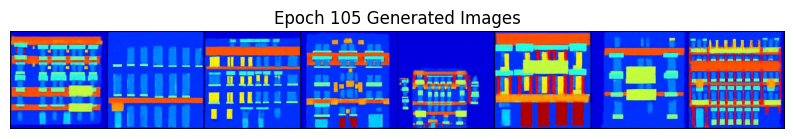

Inception Score (IS): 3.0864 ± 0.2831
Fréchet Inception Distance (FID): 174.0677
---------------------------------------------------------------
Epoch 106/120, Loss D: 0.11314065009355545, Loss G: 8.771956443786621


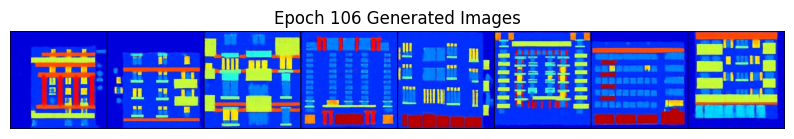

Inception Score (IS): 3.0718 ± 0.2522
Fréchet Inception Distance (FID): 173.2937
---------------------------------------------------------------
Epoch 107/120, Loss D: 0.019777720794081688, Loss G: 10.720471382141113


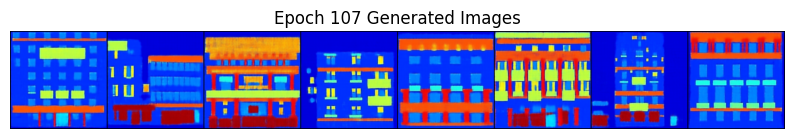

Inception Score (IS): 3.0677 ± 0.1761
Fréchet Inception Distance (FID): 172.7634
---------------------------------------------------------------
Epoch 108/120, Loss D: 0.01727958768606186, Loss G: 9.92921257019043


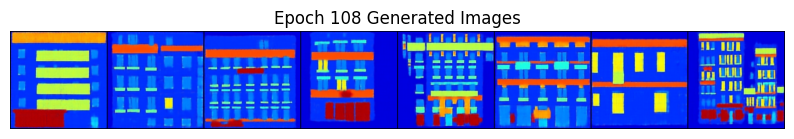

Inception Score (IS): 3.0694 ± 0.2252
Fréchet Inception Distance (FID): 172.0590
---------------------------------------------------------------
Epoch 109/120, Loss D: 0.005259763449430466, Loss G: 11.329229354858398


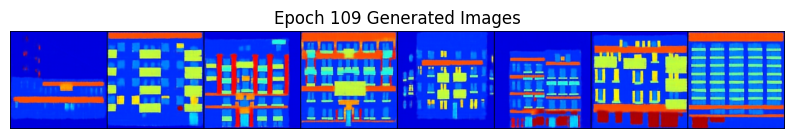

Inception Score (IS): 3.0699 ± 0.1883
Fréchet Inception Distance (FID): 171.7501
---------------------------------------------------------------
Epoch 110/120, Loss D: 0.5934109687805176, Loss G: 7.018208980560303


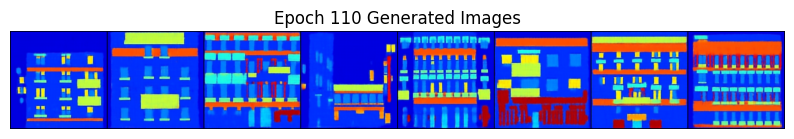

Inception Score (IS): 3.0786 ± 0.2069
Fréchet Inception Distance (FID): 171.3295
---------------------------------------------------------------
Epoch 111/120, Loss D: 0.40047186613082886, Loss G: 6.024204730987549


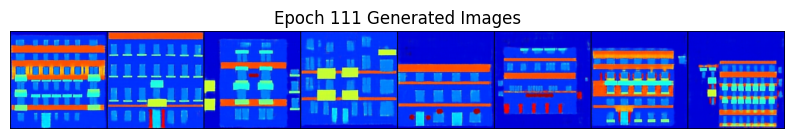

Inception Score (IS): 3.0956 ± 0.2655
Fréchet Inception Distance (FID): 170.7141
---------------------------------------------------------------
Epoch 112/120, Loss D: 0.14973732829093933, Loss G: 7.6996846199035645


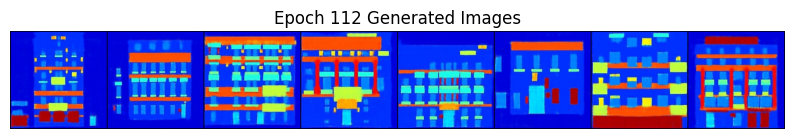

Inception Score (IS): 3.0939 ± 0.2578
Fréchet Inception Distance (FID): 170.4153
---------------------------------------------------------------
Epoch 113/120, Loss D: 0.482382595539093, Loss G: 7.117771148681641


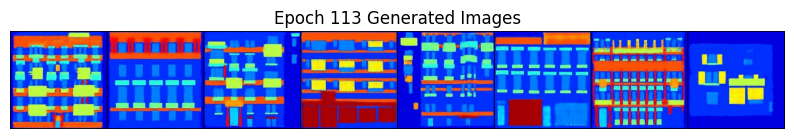

Inception Score (IS): 3.0845 ± 0.1847
Fréchet Inception Distance (FID): 170.3506
---------------------------------------------------------------
Epoch 114/120, Loss D: 0.5640144348144531, Loss G: 8.80876636505127


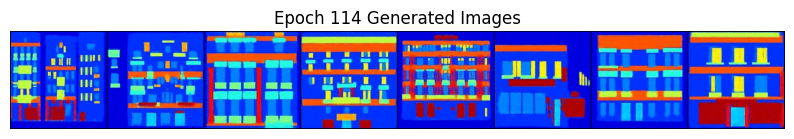

Inception Score (IS): 3.1003 ± 0.1547
Fréchet Inception Distance (FID): 170.2716
---------------------------------------------------------------
Epoch 115/120, Loss D: 0.19238591194152832, Loss G: 8.621257781982422


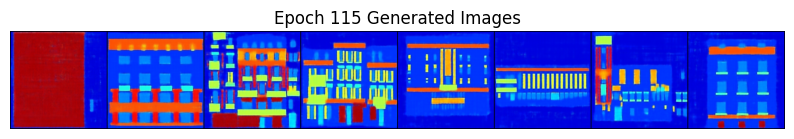

Inception Score (IS): 3.0939 ± 0.1739
Fréchet Inception Distance (FID): 169.8382
---------------------------------------------------------------
Epoch 116/120, Loss D: 0.07828603684902191, Loss G: 10.71458625793457


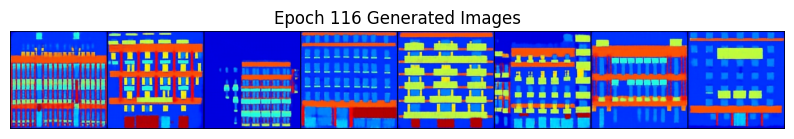

Inception Score (IS): 3.1138 ± 0.1375
Fréchet Inception Distance (FID): 169.1925
---------------------------------------------------------------
Epoch 117/120, Loss D: 0.008307836018502712, Loss G: 11.216697692871094


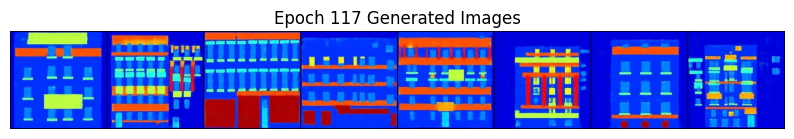

Inception Score (IS): 3.1160 ± 0.1721
Fréchet Inception Distance (FID): 168.9342
---------------------------------------------------------------
Epoch 118/120, Loss D: 0.3251453936100006, Loss G: 5.5633463859558105


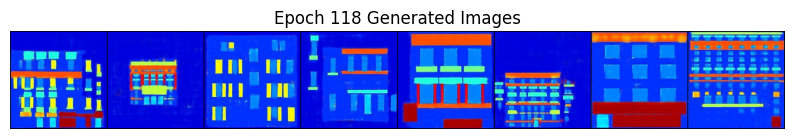

Inception Score (IS): 3.1185 ± 0.1752
Fréchet Inception Distance (FID): 168.5098
---------------------------------------------------------------
Epoch 119/120, Loss D: 0.18603576719760895, Loss G: 7.794496059417725


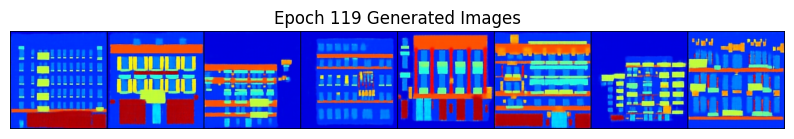

Inception Score (IS): 3.1072 ± 0.2667
Fréchet Inception Distance (FID): 167.7675
---------------------------------------------------------------
Epoch 120/120, Loss D: 0.10596373677253723, Loss G: 9.095470428466797


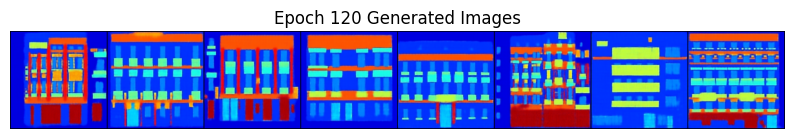

Inception Score (IS): 3.1155 ± 0.2232
Fréchet Inception Distance (FID): 167.6179


In [ ]:
generator = UNetGenerator()
discriminator = PatchGANDiscriminator()
train(generator, discriminator, dataloader)

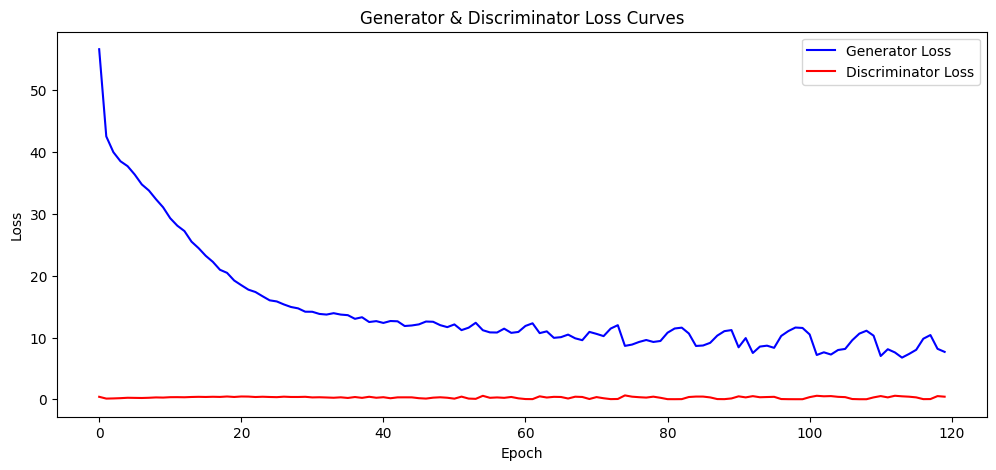

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(loss_G_list, label="Generator Loss", color='blue')
plt.plot(loss_D_list, label="Discriminator Loss", color='red')
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("Generator & Discriminator Loss Curves")
plt.legend()
plt.show()

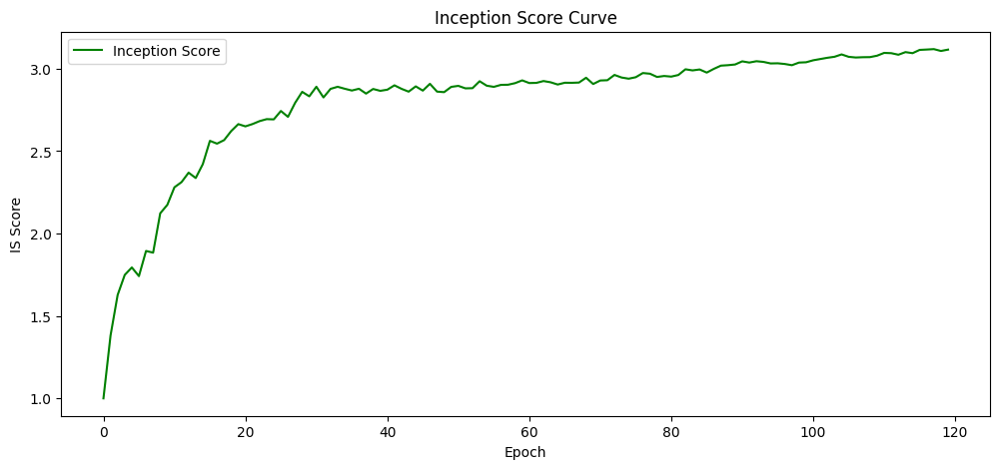

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(is_scores, label="Inception Score", color='green')
plt.xlabel("Epoch")
plt.ylabel("IS Score")
plt.title("Inception Score Curve")
plt.legend()
plt.show()

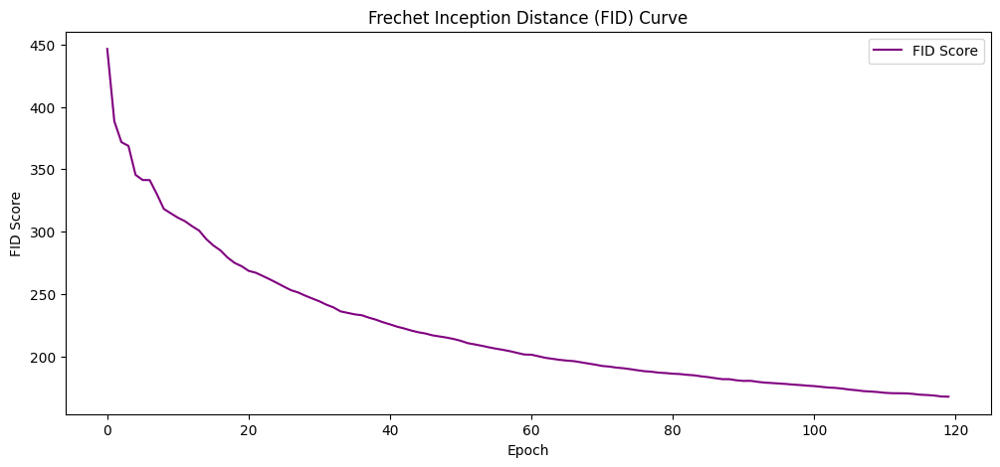

In [ ]:
plt.figure(figsize=(12, 5))
plt.plot(fid_scores, label="FID Score", color='purple')
plt.xlabel("Epoch")
plt.ylabel("FID Score")
plt.title("Frechet Inception Distance (FID) Curve")
plt.legend()
plt.show()

### Visualising Results

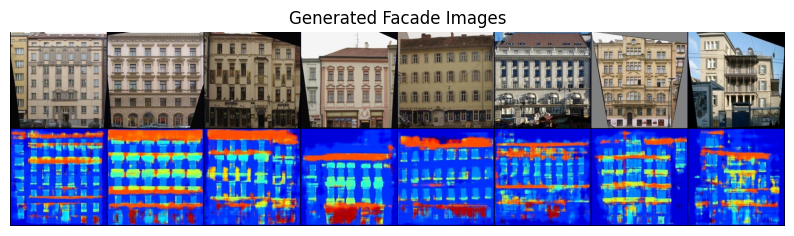

In [ ]:
test_images, _ = next(iter(test_dataloader))
test_images = test_images.to(device)

with torch.no_grad():
    generated_images = generator(test_images)

grid = vutils.make_grid(torch.cat([test_images, generated_images], dim=0), normalize=True, scale_each=True)

plt.figure(figsize=(10, 10))
plt.axis("off")
plt.title("Generated Facade Images")
plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
plt.show()

In [ ]:
def evaluate_metrics(generator, dataloader, device):
    generator.to(device)
    generator.eval()

    inception = InceptionScore().to(device)
    fid = FrechetInceptionDistance().to(device)

    with torch.no_grad():
        for input_img, real_img in dataloader:
            input_img, real_img = input_img.to(device), real_img.to(device)
            fake_img = generator(input_img)

            fake_img_uint8 = ((fake_img + 1) * 127.5).clamp(0, 255).to(torch.uint8)
            real_img_uint8 = ((real_img + 1) * 127.5).clamp(0, 255).to(torch.uint8)

            inception.update(fake_img_uint8)
            fid.update(fake_img_uint8, real=False)
            fid.update(real_img_uint8, real=True)

    is_mean, is_std = inception.compute()
    fid_value = fid.compute()

    print(f"Inception Score (IS): {is_mean:.4f} ± {is_std:.4f}")
    print(f"Frechet Inception Distance (FID): {fid_value:.4f}")

evaluate_metrics(generator, test_dataloader, device)

Inception Score (IS): 1.8743 ± 0.2334
Frechet Inception Distance (FID): 241.9758
